In [16]:
import pandas as pd
import numpy as np
import pickle
import matplotlib.pyplot as plt
import seaborn as sns
from rdkit import Chem
from matplotlib.colors import LogNorm
from featurizers.morgan import ECFP6
from sklearn.decomposition import PCA
from kmeans import get_centroids, get_cluster_id
from visualize import *
import matplotlib.lines as mlines
import imageio

In [2]:
feat_name = 'molformer'

In [3]:
# dataset and featurization
qm9 = pd.read_csv('data/qm9.csv') # qm9 dataset
qm9['gap'] = qm9['gap']*27.2114
if feat_name == 'morgan':
    feat = pd.read_csv(f'data/{feat_name}/qm9_ECFP6.csv')
    feat_cols = [f'bit{i}' for i in range(2048)]
elif feat_name == 'molformer': 
    feat = pd.read_csv(f'data/{feat_name}/qm9_molformer.csv').drop(columns='Unnamed: 0')
    feat_cols = [f'mf{i}' for i in range(768)]

# col names
prop_cols = ['A', 'B', 'C', 'mu', 'alpha', 'homo', 'lumo', 'gap',
       'r2', 'zpve', 'u0', 'u298', 'h298', 'g298', 'cv', 'u0_atom',
       'u298_atom', 'h298_atom', 'g298_atom']

# combine features with dataset
for col in prop_cols:
    feat[col] = qm9[col]

# PCA 
pca = PCA(n_components=2)
feat_pca = pca.fit_transform(feat[feat_cols])
feat['PCA 1'], feat['PCA 2']  = feat_pca[:,0], feat_pca[:,1]

<Figure size 432x288 with 0 Axes>

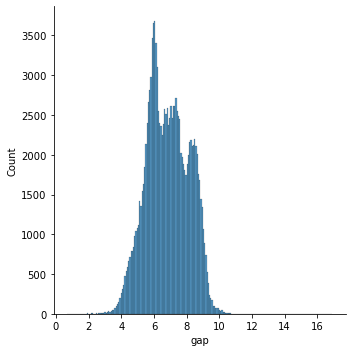

In [4]:
plt.figure()
sns.displot(feat['gap'])

No handles with labels found to put in legend.


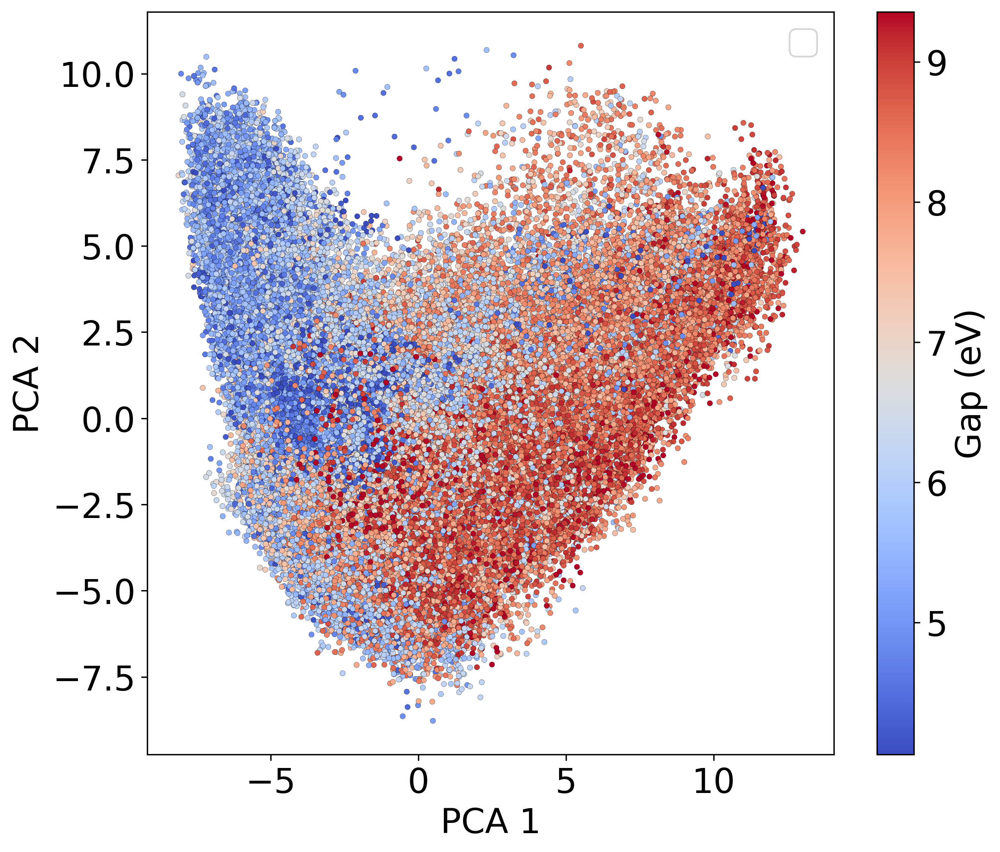

In [5]:
fig = plt.figure(figsize=(9,8), dpi=300)
plt.scatter(feat['PCA 1'], feat['PCA 2'], 
            # c=feat['gap'], 
            c=feat['gap'],
            marker='o', s=10, cmap='coolwarm', linewidth=0.1, edgecolors='black', alpha=1.,
            # norm=LogNorm(),
            vmin=np.quantile(feat['gap'], 0.01), vmax=np.quantile(feat['gap'], 0.99),
            )

cb = plt.colorbar()
cb.set_label(label='Gap (eV)', size=20)
cb.ax.tick_params(labelsize=20)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.xlabel('PCA 1', fontsize=20)
plt.ylabel('PCA 2', fontsize=20)
plt.legend(fontsize=20)

plt.show()

In [6]:
# mask out bottom 40% of gaps
percentile = 0.4
feat_masked = feat[feat['gap'] > np.quantile(feat['gap'], percentile)]
feat_masked

,mf0,mf1,mf2,mf3,mf4,mf5,mf6,mf7,mf8,mf9,...,u298,h298,g298,cv,u0_atom,u298_atom,h298_atom,g298_atom,PCA 1,PCA 2
0,1.570910,-0.655506,-0.714697,0.506979,-1.773259,-0.124519,-0.132980,0.122591,-0.756675,-0.946420,...,-40.476062,-40.475117,-40.498597,6.469,-395.999595,-398.643290,-401.014647,-372.471772,0.838253,2.093732
1,1.346863,-0.515388,-0.923589,0.282632,-1.815419,0.384753,0.670595,-0.040836,-1.452231,-0.627265,...,-56.523026,-56.522082,-56.544961,6.316,-276.861363,-278.620271,-280.399259,-259.338802,-0.093653,0.861773
2,-0.657108,-1.391719,-1.364744,0.080398,0.870743,-1.365248,-0.746766,0.127994,0.705427,-0.619653,...,-76.401867,-76.400922,-76.422349,6.002,-213.087624,-213.974294,-215.159658,-201.407171,-3.669281,5.498061
3,-0.718718,-1.332196,-1.426547,-0.017464,0.827462,-1.206831,-0.582996,0.078008,0.570870,-0.617193,...,-77.305527,-77.304583,-77.327429,8.574,-385.501997,-387.237686,-389.016047,-365.800724,-3.576157,5.377734
4,1.139330,-0.598405,-0.656275,0.381905,-2.025091,0.112912,-0.094676,-0.249480,-0.884931,-0.389520,...,-93.409370,-93.408425,-93.431246,6.278,-301.820534,-302.906752,-304.091489,-288.720028,0.380965,1.325083
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
133880,1.177948,-0.856811,0.044951,0.513531,-1.094983,0.506505,-0.218631,0.498055,-0.697508,-1.135659,...,-400.628599,-400.627654,-400.663098,23.658,-1603.983913,-1614.898804,-1623.788097,-1492.819438,7.889298,4.557907
133881,1.190647,-0.761308,0.147751,0.333469,-1.000638,0.347620,-0.103498,0.121489,-1.111307,-0.837472,...,-400.624444,-400.623500,-400.658942,23.697,-1601.376613,-1612.291504,-1621.181424,-1490.211511,8.887306,4.673682
133882,0.979099,-0.127247,0.449104,0.145297,-0.555719,0.607556,-0.726428,0.378873,-0.398404,-1.045405,...,-380.748619,-380.747675,-380.783148,23.972,-1667.045429,-1678.830048,-1688.312964,-1549.143391,6.450322,3.814709
133883,1.338802,-0.445495,0.584951,0.312261,-0.685805,0.395422,-0.257307,0.391754,-0.396126,-1.214966,...,-364.714974,-364.714030,-364.749650,24.796,-1794.600439,-1807.210860,-1817.286772,-1670.349892,7.732983,2.939468


In [7]:
# random splits
n_seeds = 10
n_samples = [5, 10, 20, 50, 100, 200]
for n_sample in n_samples:
    for seed in range(n_seeds):
        feat_masked.sample(n_sample, random_state=seed).to_csv(f'data/{feat_name}/splits/random/warmup_n{n_sample}_s{seed}.csv', index=False)

In [8]:
# get centroids and cluster ids for each point
n_centroids = 5
centroids = get_centroids(data=feat_masked[['PCA 1', 'PCA 2']], num_centroids=n_centroids)
cluster_ids = get_cluster_id(feat_masked[['PCA 1', 'PCA 2']], centroids) 
feat_masked['cluster_id'] = cluster_ids

100%|██████████| 80282/80282 [00:01<00:00, 47197.86it/s]
/home/synthesisproject/anaconda3/envs/bayes-warmup/lib/python3.7/site-packages/pandas/core/frame.py:3607: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_item(key, value)


In [9]:
# fragment split
for n_sample in n_samples:
    for cluster_id in range(n_centroids):
        feat_masked_frag = feat_masked[feat_masked['cluster_id'] == cluster_id]
        for seed in range(n_seeds):
            feat_masked_frag.sample(n_sample, random_state=seed).to_csv(f'data/{feat_name}/splits/fragment/warmup_n{n_sample}_c{cluster_id}_s{seed}.csv', index=False)

In [10]:
# stratified split
assert n_sample%n_centroids == 0, 'n_sample must be divisible by n_centroids'
for n_sample in n_samples:
    for seed in range(n_seeds):
        stratified_samples = []
        for cluster_id in range(n_centroids):
            samples = feat_masked[feat_masked['cluster_id'] == cluster_id].sample(int(n_sample/n_centroids), random_state=seed)
            stratified_samples.append(samples)
        stratified_samples = pd.concat(stratified_samples)
        stratified_samples.to_csv(f'data/{feat_name}/splits/stratified/warmup_n{n_sample}_s{seed}.csv', index=False)


In [11]:
feat_type, split, n_sample = 'molformer', 'stratified', '10'
stratified_samples = pd.read_csv(f'data/{feat_type}/splits/{split}/warmup_n{n_sample}_s8.csv')

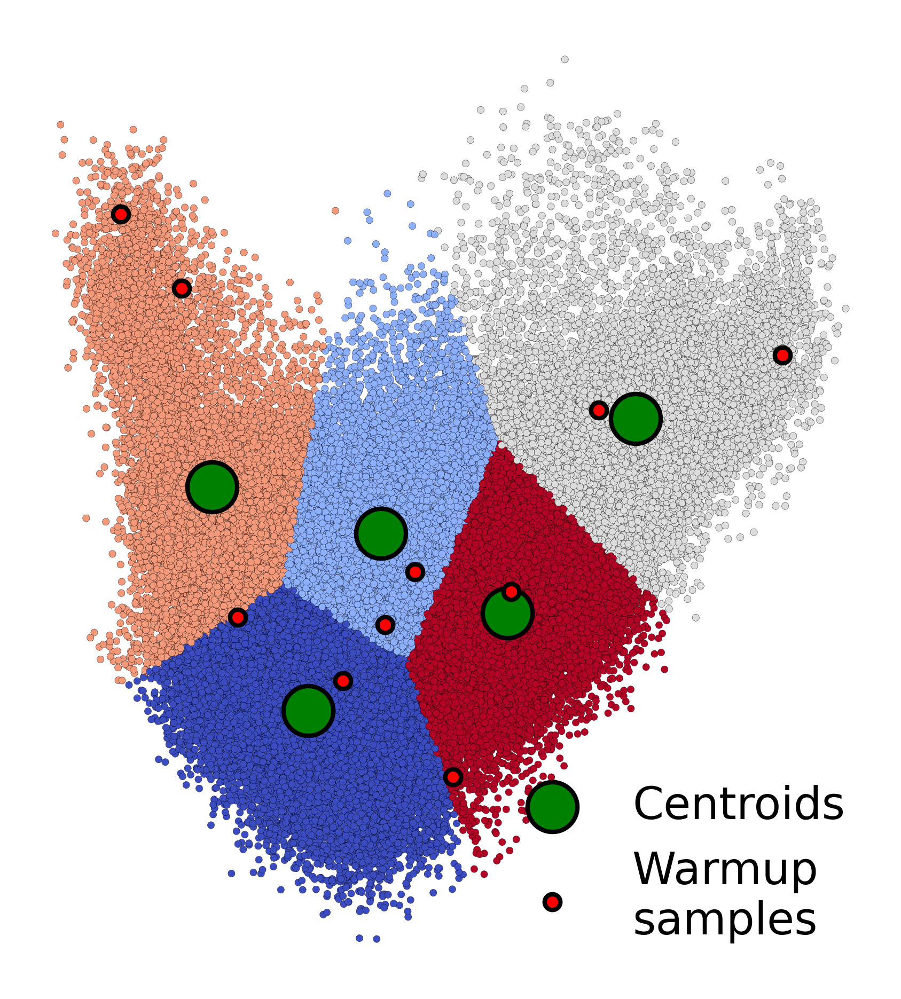

In [12]:
fig = plt.figure(figsize=(7,8), dpi=300)
plt.scatter(feat_masked['PCA 1'], feat_masked['PCA 2'], 
            c=feat_masked['cluster_id'],
            marker='o', s=10, cmap='coolwarm', linewidth=0.1, edgecolors='black', alpha=1.,
            )
plt.scatter(centroids[:,0], centroids[:,1], 
            c='g', 
            marker='o', s=500, label='Centroids', cmap='coolwarm', linewidth=2, edgecolors='black', alpha=1,
            )
plt.scatter(stratified_samples['PCA 1'], stratified_samples['PCA 2'], 
            c='r', 
            marker='o', s=50, label='Warmup \nsamples', linewidth=2, edgecolors='black', alpha=1,
            )

plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.xlabel('PCA 1', fontsize=20)
plt.ylabel('PCA 2', fontsize=20)
plt.legend(fontsize=20,loc='lower right',frameon=False)
plt.axis('off')
plt.savefig('figures/stratified.png')
plt.show()

In [13]:
feat_type, split, n_sample = 'molformer', 'random', '50'
traj, mol_trajs = get_trajectory(feat_type, split, n_sample, return_mols=True)

molformer, random, 50 non-complete seeds: 0


In [14]:
smiles_dfs = []
for smiles in mol_trajs[8]:

    smiles_df = feat[feat['smiles'] == smiles][['PCA 1', 'PCA 2', 'gap']]

    if len(smiles_df) != 1:
        smiles_df = smiles_df.sample(random_state=0)
    smiles_dfs.append(smiles_df)
smiles_dfs = pd.concat(smiles_dfs)
smiles_dfs['iter'] = range(1,51)
smiles_dfs.reset_index(inplace=True)

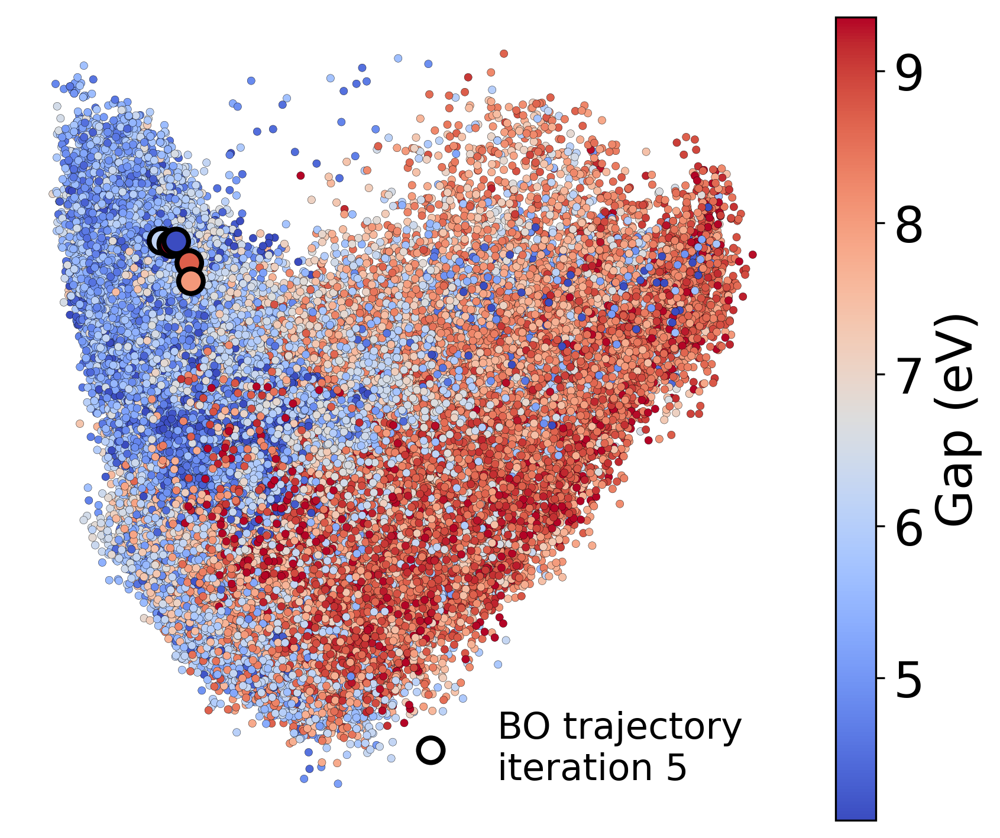

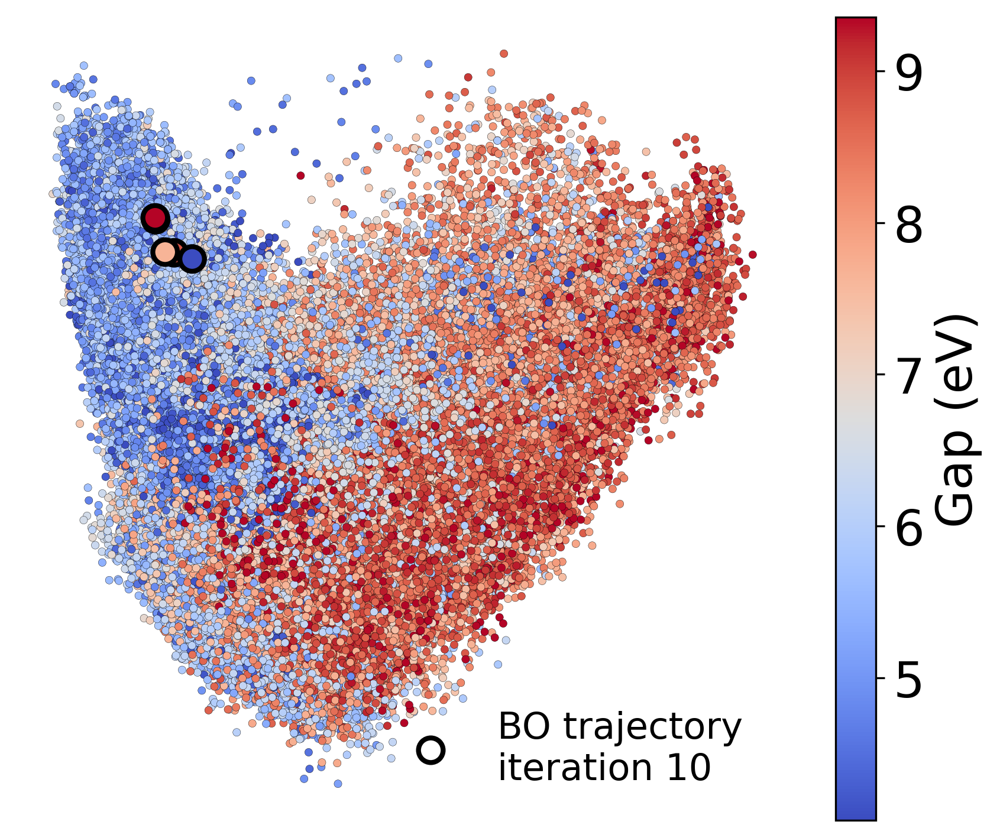

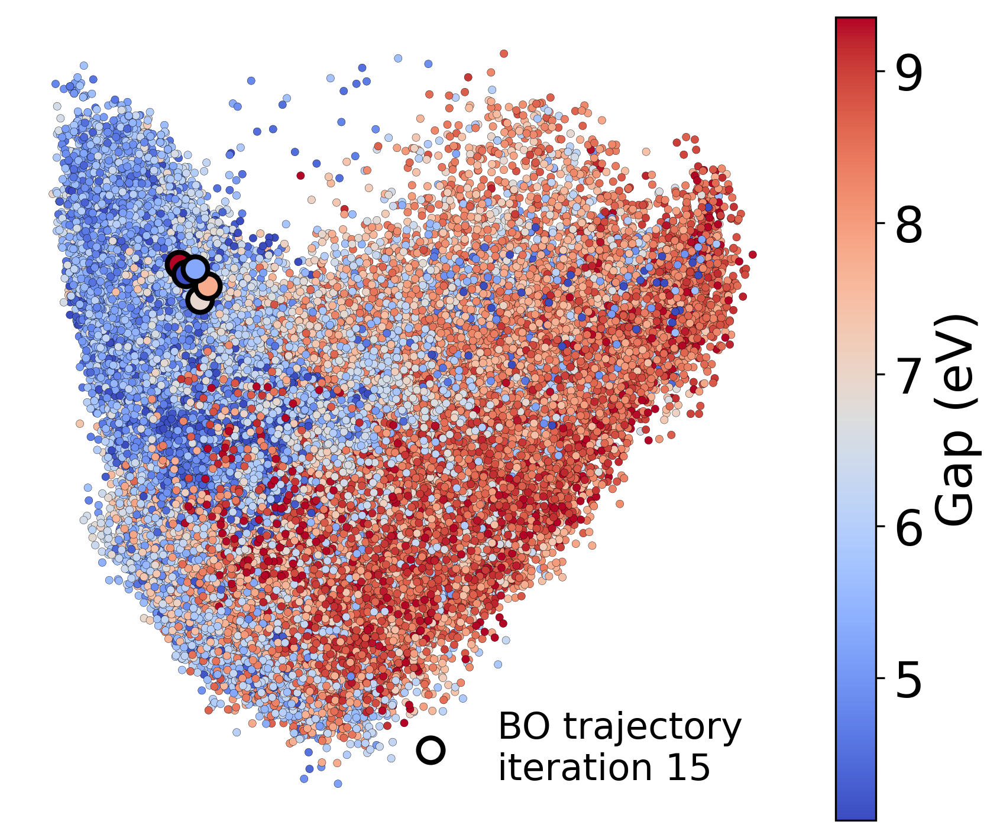

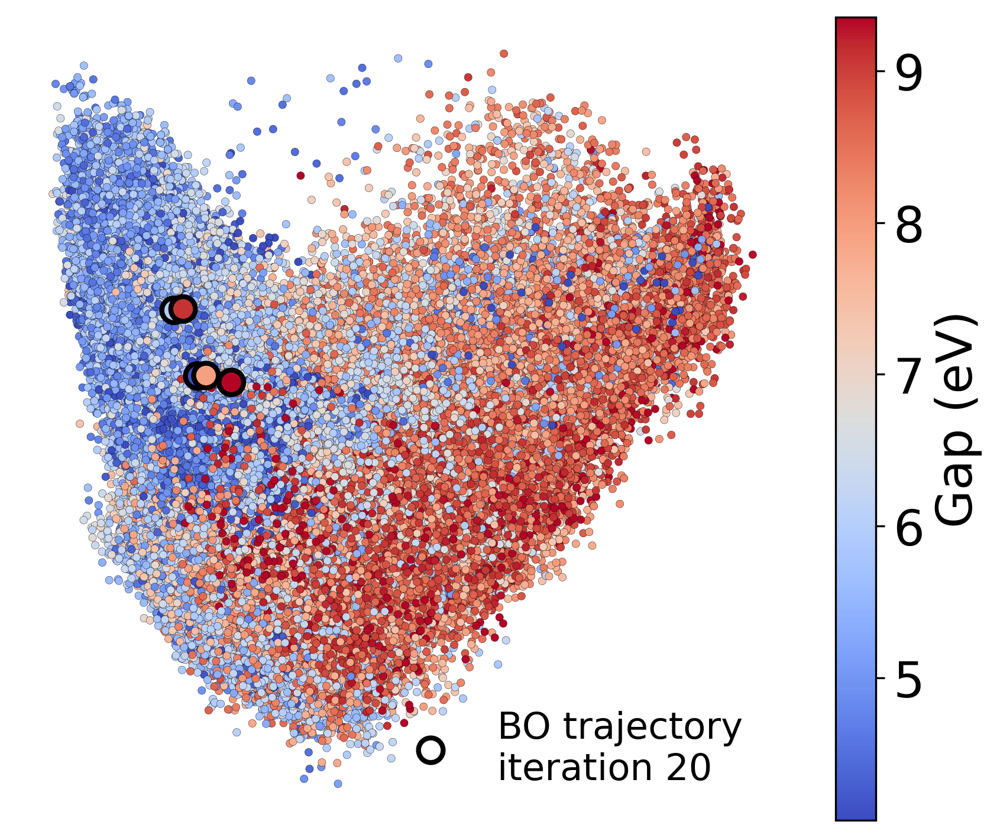

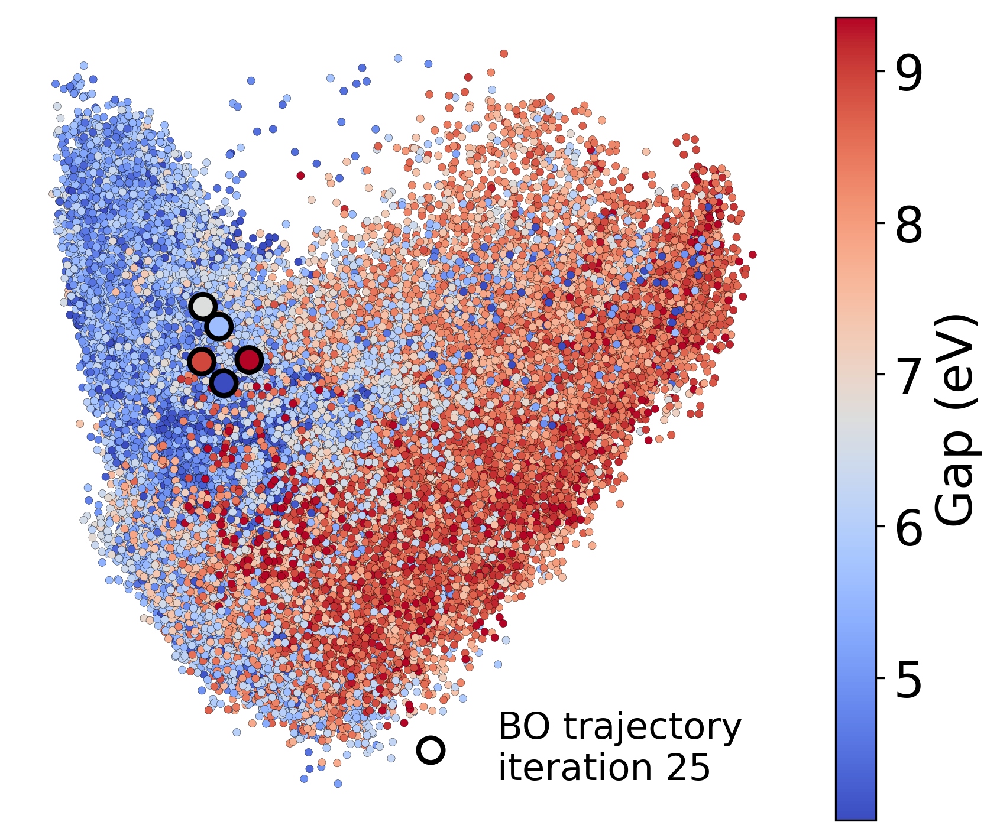

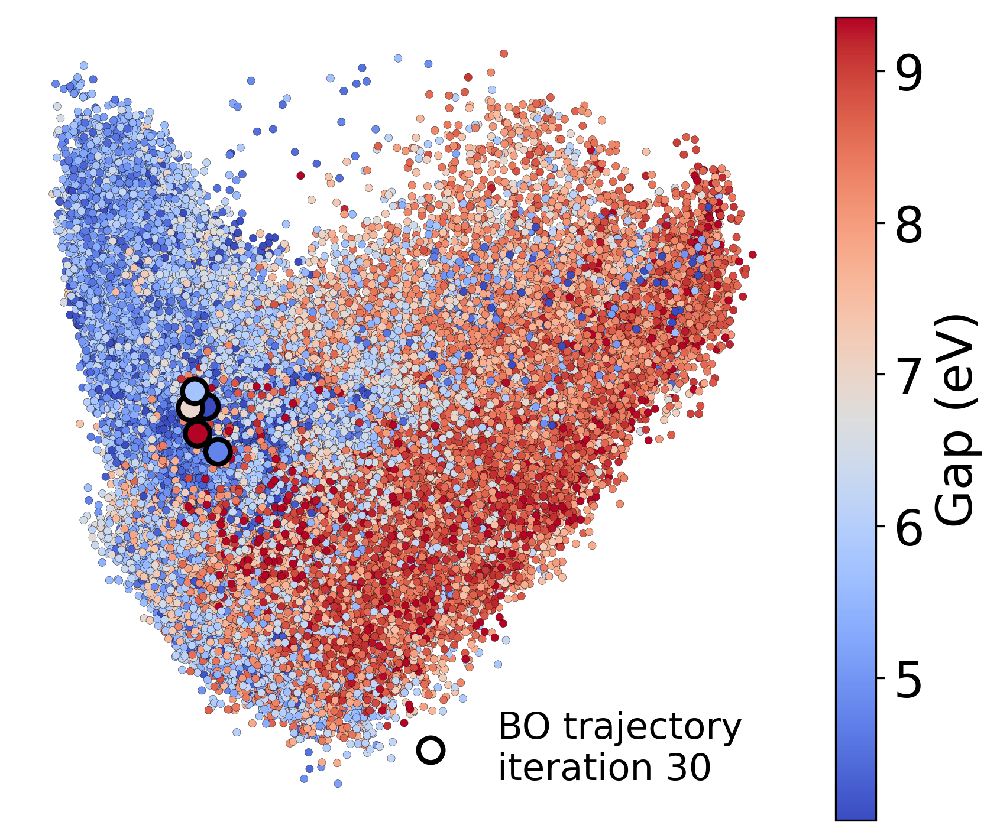

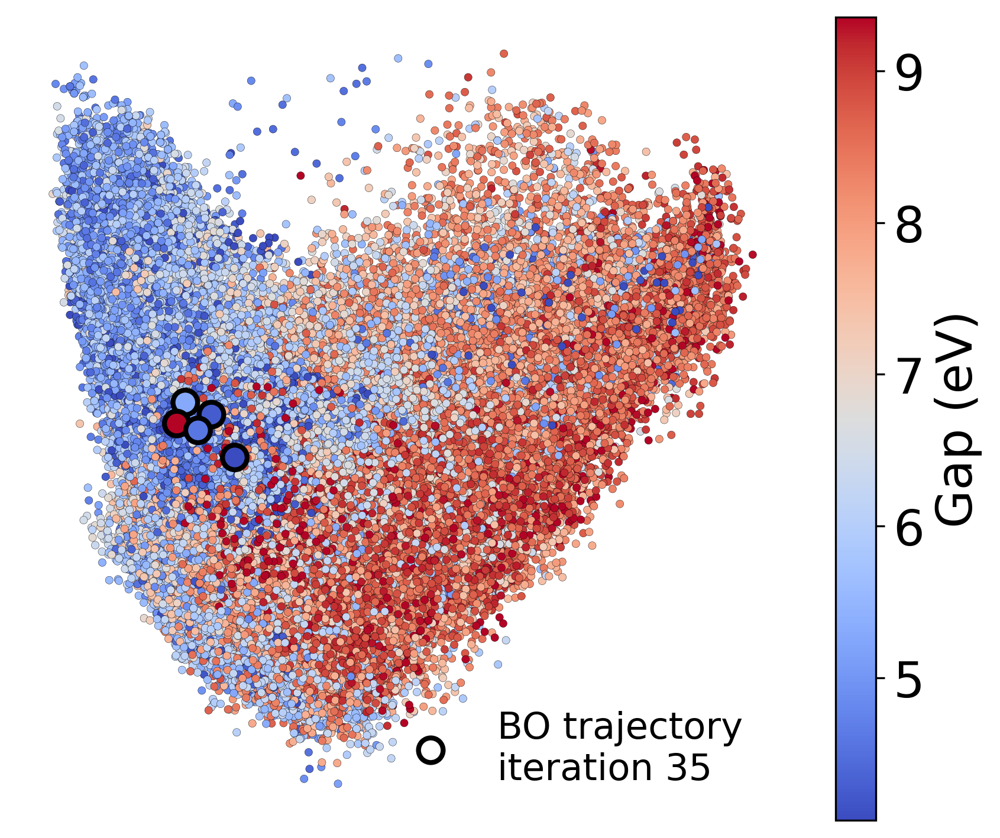

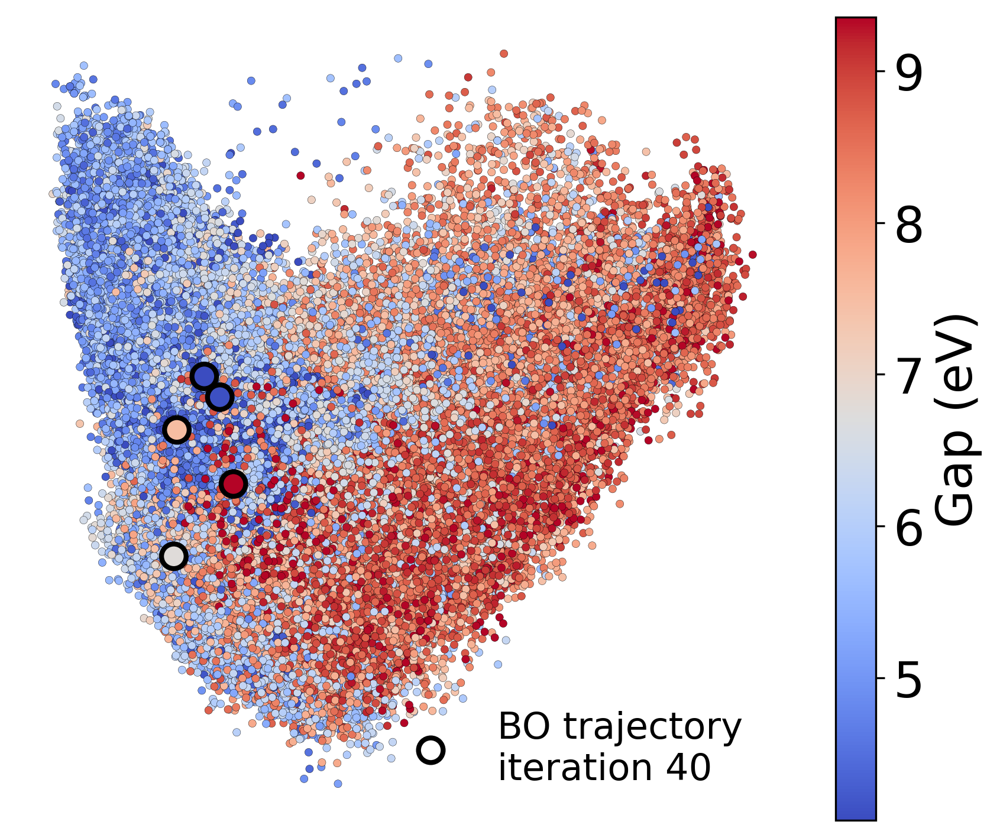

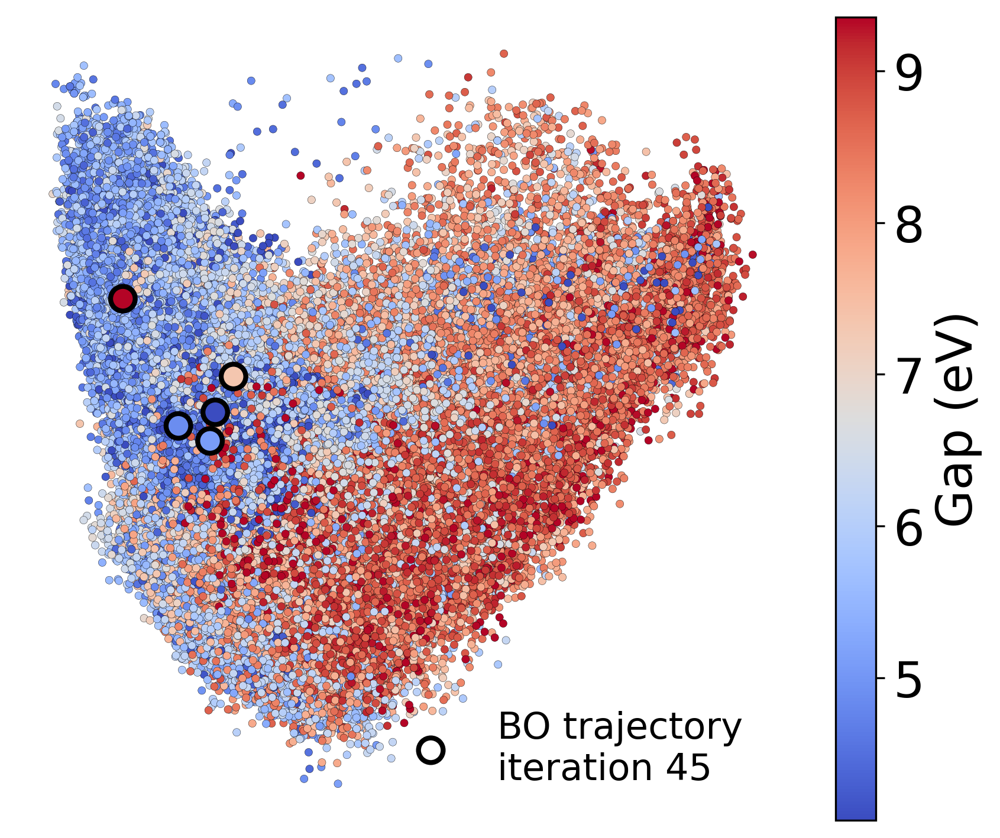

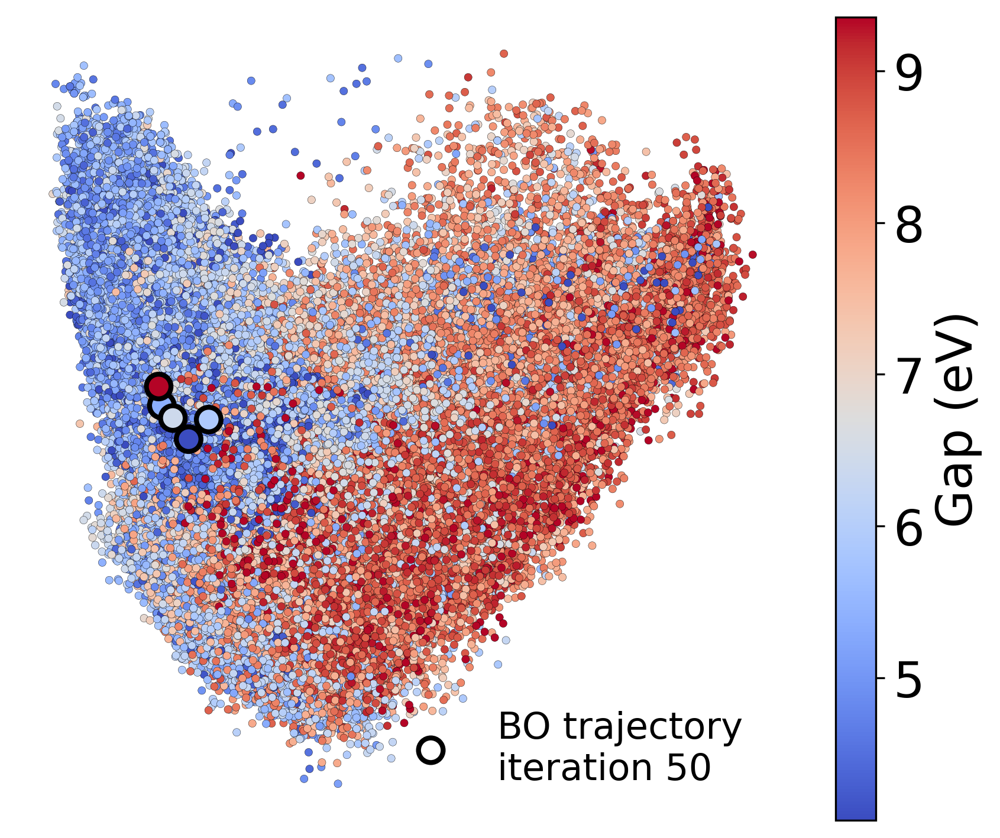

In [17]:
images = []
for i in range(10):

    start_idx = i*5
    end_idx = start_idx+5
    fig = plt.figure(figsize=(7,6), dpi=300)
    plt.scatter(feat['PCA 1'], feat['PCA 2'], 
                # c=feat['gap'], 
                c=feat['gap'],
                marker='o', s=10, cmap='coolwarm', linewidth=0.1, edgecolors='black', alpha=1.,
                # norm=LogNorm(),
                vmin=np.quantile(feat['gap'], 0.01), vmax=np.quantile(feat['gap'], 0.99),
                )

    cb = plt.colorbar()
    cb.set_label(label='Gap (eV)', size=20)
    cb.ax.tick_params(labelsize=20)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    plt.xlabel('PCA 1', fontsize=20)
    plt.ylabel('PCA 2', fontsize=20)
    

    plt.scatter(smiles_dfs.iloc[start_idx:end_idx]['PCA 1'], smiles_dfs.iloc[start_idx:end_idx]['PCA 2'], 
                c=smiles_dfs.iloc[start_idx:end_idx]['gap'],
                marker='o', s=100, cmap='coolwarm', linewidth=2., edgecolors='black', alpha=1.,
                label='BO trajectory',
                )
    
    # handles, labels = plt.gca().get_legend_handles_labels()
    # Set marker color for the first line
    # handles[0].set_color('black')  # Change color to red

    blue_line = mlines.Line2D([], [], color='white', marker='o', alpha = 1., markeredgecolor='black', markeredgewidth=2,
                          markersize=10, label=f'BO trajectory \niteration {end_idx}')
    # plt.text(7,-7, 'Iteration', fontsize=15)
    plt.legend(handles=[blue_line],fontsize=15,frameon=False, loc='lower right')
    plt.axis('off')

    # ====================== FOR SAVING INTO GIF ======================
    # Used to return the plot as an image array 
    # (https://ndres.me/post/matplotlib-animated-gifs-easily/)
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    images.append(image)  

    plt.show()

# save images as a gif    
imageio.mimsave('figures/bo_trajectory.gif', images, fps=6)